# Classification

## K-Nearest Neighbors

Kode program berikut mengimplementasikan algoritma K-NN dengan library [scikit-learn](https://scikit-learn.org/stable/auto_examples/neighbors/plot_classification.html#sphx-glr-auto-examples-neighbors-plot-classification-py).

### 1. Import library yang diperlukan

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn import neighbors, datasets
from sklearn.neighbors import DistanceMetric

### 2. Load Dataset

Di sini kita akan menggunakan dataset bunga Iris.

![Iris](https://s3.amazonaws.com/assets.datacamp.com/blog_assets/Machine+Learning+R/iris-machinelearning.png). 

In [2]:
iris = datasets.load_iris()

Penjelasan mengenai dataset Iris

In [3]:
iris.DESCR

'.. _iris_dataset:\n\nIris plants dataset\n--------------------\n\n**Data Set Characteristics:**\n\n    :Number of Instances: 150 (50 in each of three classes)\n    :Number of Attributes: 4 numeric, predictive attributes and the class\n    :Attribute Information:\n        - sepal length in cm\n        - sepal width in cm\n        - petal length in cm\n        - petal width in cm\n        - class:\n                - Iris-Setosa\n                - Iris-Versicolour\n                - Iris-Virginica\n                \n    :Summary Statistics:\n\n    ============== ==== ==== ======= ===== ====================\n                    Min  Max   Mean    SD   Class Correlation\n    ============== ==== ==== ======= ===== ====================\n    sepal length:   4.3  7.9   5.84   0.83    0.7826\n    sepal width:    2.0  4.4   3.05   0.43   -0.4194\n    petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)\n    petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)\n    ============== ==== =

### 3. Pisahkan data untuk training dan untuk testing.

Pada bagian ini kita hanya menggunakan dua fitur dari bunga Iris saja.

In [4]:
X = iris.data[:, :2]
y = iris.target

#### 3.1 Fitur

In [5]:
print(X[:5])   # Tampilkan lima baris pertama

[[5.1 3.5]
 [4.9 3. ]
 [4.7 3.2]
 [4.6 3.1]
 [5.  3.6]]


#### 3.2 Label

In [6]:
print(y[:5])    # Tampilkan lima baris pertama

[0 0 0 0 0]


### 4. Inisialisasi hyper-parameter

In [7]:
jumlah_neighbors = 15
weights = ['uniform', 'distance']
metrics = ['euclidean', 'manhattan', 'chebyshev', 'minkowski', 
          'wminkowski', 'seuclidean', 'mahalanobis']

### 5. Modeling dengan K-NN

K-NN diimplementasikan dengan kelas `neighbors.KNeighborsClassifier()` pada scikit-learn.

In [8]:
knn_classifier = neighbors.KNeighborsClassifier(jumlah_neighbors, 
                                                weights=weights[0], # weights = 'uniform'
                                                metric=metrics[0])  # metrics = 'euclidian'
knn_classifier.fit(X, y)    # Fit data training dan testing ke classifier

KNeighborsClassifier(metric='euclidean', n_neighbors=15)

In [9]:
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
h = .02
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Lakukan prediksi
Z = knn_classifier.predict(np.c_[xx.ravel(), yy.ravel()])

Visualisasi

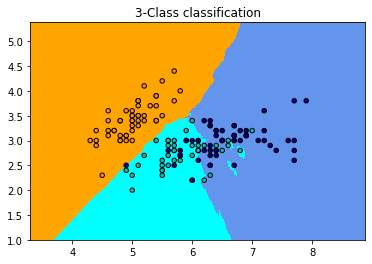

In [10]:
cmap_light = ListedColormap(['orange', 'cyan', 'cornflowerblue'])
cmap_bold = ListedColormap(['darkorange', 'c', 'darkblue'])
Z = Z.reshape(xx.shape)
plt.figure()
plt.pcolormesh(xx, yy, Z, shading='auto', cmap=cmap_light)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap_bold, edgecolor='k', s=20)
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.title('3-Class classification')

plt.show()

Bagaimana jika menggunakan `weight='distance'` pada saat pendefinisian `neighbors.KNeighborsClassifier()`.

In [11]:
X = iris.data[:, :2]
y = iris.target

knn_classifier = neighbors.KNeighborsClassifier(jumlah_neighbors, 
                                                weights=weights[1], # weights = 'distance'
                                                metric=metrics[0])  # metrics = 'euclidian'
knn_classifier.fit(X, y)

x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
Z = knn_classifier.predict(np.c_[xx.ravel(), yy.ravel()])

Visualisasi

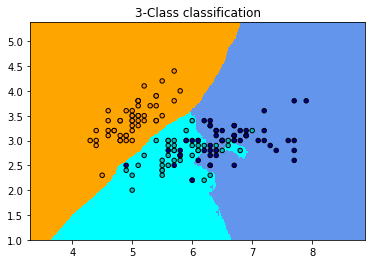

In [12]:
cmap_light = ListedColormap(['orange', 'cyan', 'cornflowerblue'])
cmap_bold = ListedColormap(['darkorange', 'c', 'darkblue'])
Z = Z.reshape(xx.shape)
plt.figure()
plt.pcolormesh(xx, yy, Z, shading='auto', cmap=cmap_light)

# Plot also the training points
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap_bold, edgecolor='k', s=20)
plt.xlim(xx.min(), xx.max())
plt.ylim(yy.min(), yy.max())
plt.title('3-Class classification')

plt.show()

Penjelasan mengenai visualisasi.

![viz](img/knn-1.png)

### 6. Menggunakan seluruh fitur dalam dataset Iris.

Jika sebelumnya kita hanya menggunakan dua fitur, sedangkan di bagian ini kita akan menggunakan seluruh fitur yang ada.

In [13]:
X = iris.data
y = iris.target
h = .02

#### 6.1 DataFrame Format

Kita masukkan dataset dari scikit-learn ke dalam format struktur data DataFrame dari library **pandas**.

In [14]:
import pandas as pd

X = pd.DataFrame(iris.data, columns=['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)', 'petal width (cm)'])
y = pd.DataFrame(iris.target, columns=['Class'])

In [15]:
X.head()    # Tampilkan sebagian data

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [16]:
y.head()

,Class
0,0
1,0
2,0
3,0
4,0


Seperti terlihat pada tabel di atas, dataset disajikan dalam bentuk tabel daripada bentuk array/list sehingga lebih mudah dibaca dan diinterpretasikan.

#### 6.2 Bagi dataset menjadi data train dan data test

Proses pembagian dataset menggunakan method `train_test_split()` dari library scikit-learn.

In [17]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X[['sepal length (cm)', 'sepal width (cm)', 
                                                       'petal length (cm)', 'petal width (cm)']],
                                                    y['Class'], random_state=111)
print('X_train shape: {} \n y_train shape: {}'.format(X_train.shape, y_train.shape))
print('X_test shape: {} \n y_test shape: {}'.format(X_test.shape, y_test.shape))

X_train shape: (112, 4) 
 y_train shape: (112,)
X_test shape: (38, 4) 
 y_test shape: (38,)


#### 6.3 Training Data

In [18]:
knn_classifier = neighbors.KNeighborsClassifier(n_neighbors=jumlah_neighbors)
knn_classifier.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=15)

#### 6.4 Prediksi pada data test

In [19]:
y_pred = knn_classifier.predict(X_test)

#### 6.5 Tampilkan hasil prediksi dalam tabel

In [20]:
pd.concat([X_test, y_test, pd.Series(y_pred, name='Predicted', index=X_test.index)],
          ignore_index=False, axis=1).head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),Class,Predicted
39,5.1,3.4,1.5,0.2,0,0
26,5.0,3.4,1.6,0.4,0,0
109,7.2,3.6,6.1,2.5,2,2
123,6.3,2.7,4.9,1.8,2,2
77,6.7,3.0,5.0,1.7,1,2


#### 6.6 Nilai Prediksi

In [21]:
print('Nilai prediksi: {}'.format(knn_classifier.score(X_test, y_test)))

Nilai prediksi: 0.9736842105263158
